In [26]:
import sys
import os
import os.path as op
import shutil
from glob import glob
from importlib import reload
from collections import OrderedDict as od

import numpy as np
import pandas as pd
import scipy.stats as stats
from scipy.io import loadmat
from scipy.io import savemat
import h5py
from matplotlib.backends.backend_pdf import PdfPages

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['lines.linewidth'] = 1
mpl.rcParams['lines.markersize'] = 3
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
colors = ['#1f77b4', '#d62728', '#2ca02c', '#ff7f0e', '#9467bd', 
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
mpl.rcParams['axes.prop_cycle'] = mpl.cycler('color', colors)
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.formatter.offset_threshold'] = 2
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['axes.labelpad'] = 8
mpl.rcParams['axes.titlesize'] = 16
mpl.rcParams['axes.grid'] = False
mpl.rcParams['axes.axisbelow'] = True
mpl.rcParams['legend.fontsize'] = 12
mpl.rcParams['legend.frameon'] = False
mpl.rcParams['figure.titlesize'] = 16
mpl.rcParams['figure.subplot.wspace'] = 0.25 
mpl.rcParams['figure.subplot.hspace'] = 0.25 

import mne
sys.path.append('/Users/danielschonhaut/penn/lab/code/general')
import data_io as dio
import eeg_preproc
from eeg_plotting import plot_trace, plot_trace2
sys.path.append('/Users/danielschonhaut/penn/lab/code/projects')
from time_cells import spike_preproc, spike_sorting

# Colors
n = 4
c = 2
colors = [sns.color_palette('Blues', n)[c], 
          sns.color_palette('Reds', n)[c], 
          sns.color_palette('Greens', n)[c],
          sns.color_palette('Purples', n)[c],
          sns.color_palette('Oranges', n)[c],
          sns.color_palette('Greys', n)[c],
          sns.color_palette('YlOrBr', n+3)[c],
          'k']
labelfontsize = 12
tickfontsize = 12
figfontsize = 14

In [24]:
# Load wave_clus data for the session.
subj_sess = 'U530_ses1'

subj, sess = subj_sess.split('_')
subj_dir = os.path.join('/Users/danielschonhaut/penn/lab/projects/time_cells/data', subj, sess)
spikes_dir = os.path.join(subj_dir, 'spikes', 'wave_clus3_sortbyhand')

output = spike_sorting.compile_wave_clus(subj_sess, verbose=True)
wave_clus, neurons, lfp_timestamps, sr, session_dur_ms, mont, rois = output

Conversion factor is 1
117432666 timestamps over 65 min and 14.4 s
Sampling rate is 30000 Hz
96 electrodes in 12 regions.
REC: [1 2 3 4 5 6 7 8]
RMH: [ 9 10 11 12 13 14 15 16]
ROF: [17 18 19 20 21 22 23 24]
RAC: [25 26 27 28 29 30 31 32]
LMH: [33 34 35 36 37 38 39 40]
LEC: [41 42 43 44 45 46 47 48]
LOF: [49 50 51 52 53 54 55 56]
LAC: [57 58 59 60 61 62 63 64]
LA: [65 66 67 68 69 70 71 72]
LHGa: [73 74 75 76 77 78 79 80]
LPI-SMG: [81 82 83 84 85 86 87 88]
LFOP: [89 90 91 92 93 94 95 96]
35 neurons


In [2]:
subj_sess = 'U530_ses1'

subj, sess = subj_sess.split('_')
subj_dir = os.path.join('/Users/danielschonhaut/penn/lab/projects/time_cells/data', subj, sess)
spikes_dir = os.path.join(subj_dir, 'spikes', 'wave_clus3_sortbyhand')

files = glob(op.join(spikes_dir, '*_removepli*'))
print(len(files))
for f in files:
    dname, fname = op.split(f)
    shutil.move(f, op.join(dname, fname.replace('_removepli', '')))

0


In [6]:
# exclude = [0, 2, 5, 6, 7, 8, 9, 11, 19, 20, 21, 22, 32, 33, 42, 44, 45, 46, 47, 48, 49, 50]
# neurons = [neuron for i, neuron in enumerate(neurons) if i not in exclude]

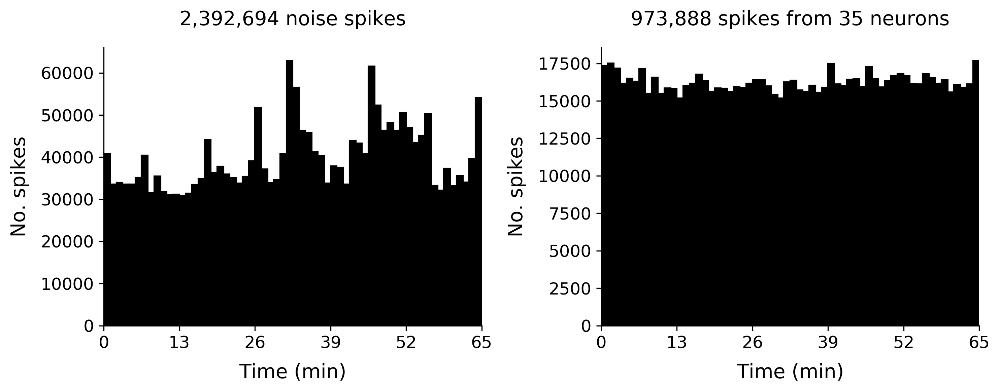

In [25]:
noise_spike_times = []
neuron_spike_times = []
chans = np.array(list(mont.values())).flatten()
n_neurons = 0
for chan in chans:
    wave_clusf = os.path.join(spikes_dir, 'times_CSC{}.mat'.format(chan))
    if os.path.exists(wave_clusf):
        dat = loadmat(wave_clusf)['cluster_class']
        noise_spike_times.extend(list(dat[np.where(dat[:, 0]==0)[0], 1]))
        neuron_spike_times.extend(list(dat[np.where(dat[:, 0]!=0)[0], 1]))
        n_neurons += len(np.unique(dat[np.where(dat[:, 0]!=0)[0], 0]))
        
noise_spike_times = np.array(noise_spike_times)
neuron_spike_times = np.array(neuron_spike_times)
xmin, xmax = np.min(noise_spike_times), np.max(noise_spike_times)

fig, ax = plt.subplots(1, 2, figsize=(10, 4), dpi=300)
ax = np.ravel(ax)

tickfontsize=12
labelfontsize=14

i = 0
if len(noise_spike_times)>0:
    ax[i].hist(noise_spike_times, bins=60, alpha=1, color='k', edgecolor='k')
    ax[i].set_xlim(xmin, xmax)
    ax[i].set_xticks(np.linspace(xmin, xmax, 6))
    ax[i].set_xticklabels(np.linspace(xmin/6e4, xmax/6e4, 6, dtype=int), fontsize=tickfontsize)
    ax[i].set_xlabel('Time (min)', fontsize=labelfontsize, labelpad=8)
    ax[i].set_ylabel('No. spikes', fontsize=labelfontsize, labelpad=8)
ax[i].set_title('{:,d} noise spikes'.format(len(noise_spike_times)), 
                fontsize=labelfontsize, y=1.05)

i = 1
if len(neuron_spike_times)>0:
    ax[i].hist(neuron_spike_times, bins=60, alpha=1, color='k', edgecolor='k')
    ax[i].set_xlim(xmin, xmax)
    ax[i].set_xticks(np.linspace(xmin, xmax, 6))
    ax[i].set_xticklabels(np.linspace(xmin/6e4, xmax/6e4, 6, dtype=int), fontsize=tickfontsize)
    ax[i].set_xlabel('Time (min)', fontsize=labelfontsize, labelpad=8)
    ax[i].set_ylabel('No. spikes', fontsize=labelfontsize, labelpad=8)
ax[i].set_title('{:,d} spikes from {:,d} neurons'.format(len(neuron_spike_times), n_neurons), 
                fontsize=labelfontsize, y=1.05)

fig.tight_layout()

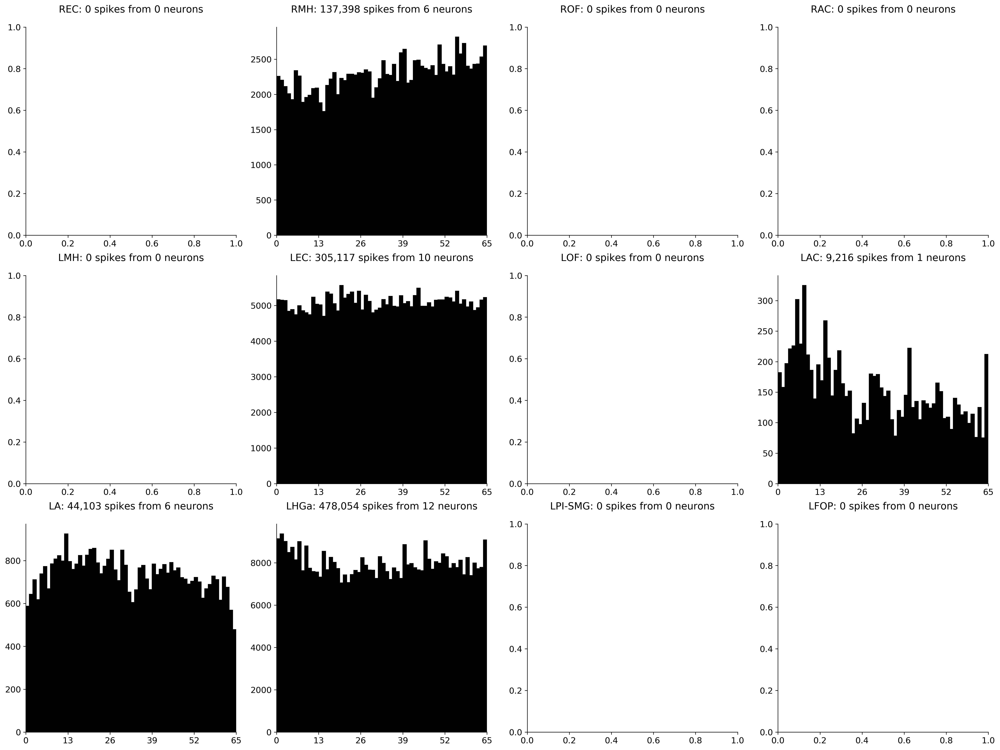

In [27]:
fig, ax = plt.subplots(3, 4, figsize=(20, 15), dpi=300)
ax = np.ravel(ax)

tickfontsize = 12
labelfontsize = 14
figfontsize = 16

spike_times = od([])
for roi in rois:    
    chans = mont[roi]
    spike_times_ = []
    n_neurons = 0
    for chan in chans:
        wave_clusf = os.path.join(spikes_dir, 'times_CSC{}.mat'.format(chan))
        if os.path.exists(wave_clusf):
            dat = loadmat(wave_clusf)['cluster_class']
            neuron_inds = np.where(dat[:, 0]!=0)[0]
            spike_times_.extend(list(dat[neuron_inds, 1]))
            n_neurons += len(np.unique(dat[neuron_inds, 0]))
    spike_times[roi] = [spike_times_, n_neurons]

for i in range(len(rois)):
    roi = rois[i]
    if spike_times[roi][0]:
        xmin, xmax = np.min(spike_times[roi][0]), np.max(spike_times[roi][0])
        ax[i].hist(spike_times[roi][0], bins=60, alpha=1, color='k', edgecolor='k')
        ax[i].set_xlim(xmin, xmax)
        ax[i].set_xticks(np.linspace(xmin, xmax, 6))
        ax[i].set_xticklabels(np.linspace(xmin/6e4, xmax/6e4, 6, dtype=int), fontsize=tickfontsize)
        if i == 0:
            ax[i].set_xlabel('Time (min)', fontsize=labelfontsize, labelpad=8)
            ax[i].set_ylabel('No. spikes', fontsize=labelfontsize, labelpad=8)
    ax[i].set_title('{}: {:,d} spikes from {:,d} neurons'.format(roi, len(spike_times[roi][0]), spike_times[roi][1]), 
                    fontsize=labelfontsize, y=1.05)

fig.tight_layout()

In [102]:
# Generate plots from the wave_clus outputs for each neuron.
output_f = os.path.join(subj_dir, 'spikes', 'wave_clus3_sortbyhand',
                        '{}_neuron_plots.pdf'.format(subj_sess))
fontsize = od([('tick', 12),
               ('label', 14),
               ('annot', 12),
               ('fig', 16)])

fig, ax = plt.subplots(8, 6, figsize=(24, 32), dpi=300)
ax = np.ravel(ax)
with PdfPages(output_f) as pdf:
    for iNeuron in range(len(neurons)):
        neuron = neurons[iNeuron]
        neuron_dat = wave_clus[neuron]
        i = (iNeuron % 16) * 3
        label_axes = True if (i == 0) else False
        
        ax[i] = spike_sorting.plot_waveforms(neuron_dat, 
                                             sr, 
                                             ax[i],
                                             label_axes=label_axes,
                                             fontsize=fontsize)
        ax[i].set_title(neuron, fontsize=fontsize['fig'], y=1.02, loc='left')
        
        i += 1
        ax[i] = spike_sorting.plot_isi_hist(neuron_dat,
                                            ax[i],
                                            color=colors[0],
                                            label_axes=label_axes,
                                            fontsize=fontsize)
        
        i += 1
        ax[i] = spike_sorting.plot_spike_stability(neuron_dat, 
                                                   session_dur_ms, 
                                                   ax[i],
                                                   label_axes=label_axes,
                                                   fontsize=fontsize)
        
        if (iNeuron % 16 == 15) and (iNeuron + 1 < len(neurons)):
            fig.tight_layout(h_pad=1.12, w_pad=1.12)
            pdf.savefig(fig, bbox_inches='tight', pad_inches=1)
            plt.close(fig)
            fig, ax = plt.subplots(8, 6, figsize=(24, 32), dpi=300)
            ax = np.ravel(ax)
    
    fig.tight_layout(h_pad=1.12, w_pad=1.12)
    pdf.savefig(fig, bbox_inches='tight', pad_inches=1)

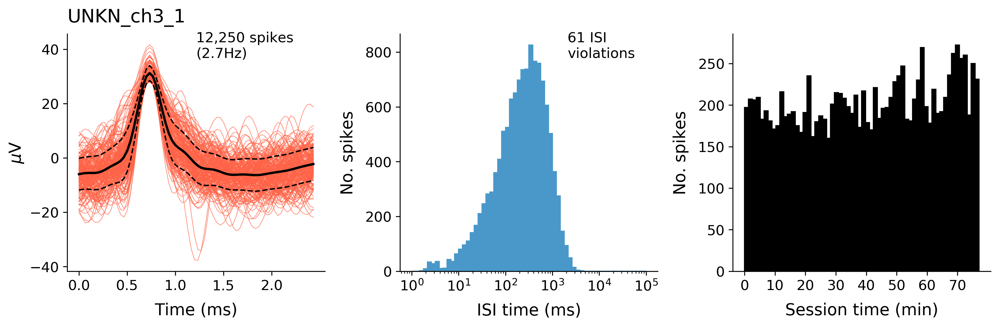

In [26]:
iNeuron = 2

neuron = neurons[iNeuron]
fig, ax = spike_sorting.plot_neuron3(wave_clus, neuron, sr, session_dur_ms, 'log')

Unit 0: 3310 spikes
Unit 1: 117153 spikes
Unit 2: 3594 spikes
Unit 3: 12010 spikes


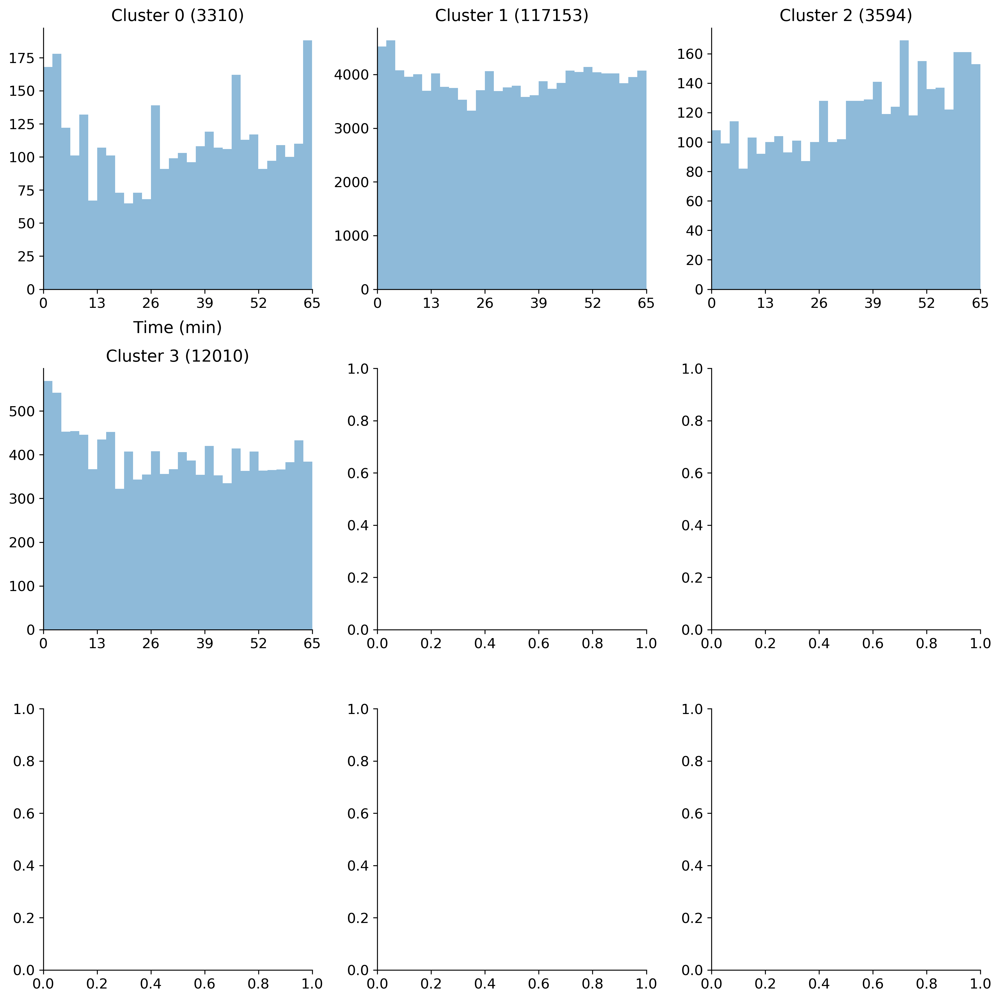

In [20]:
chan = 80
# -----------------------

wave_clusf = os.path.join(spikes_dir, 'times_CSC{}.mat'.format(chan))
if os.path.exists(wave_clusf):
    dat = loadmat(wave_clusf)['cluster_class']
    units, nspikes = np.unique(dat[:,0], return_counts=True)
    for i in range(len(units)):
        print('Unit {:.0f}: {} spikes'.format(units[i], nspikes[i]))
else:
    print('Missing {}'.format(wave_clusf))
    
fig, ax = plt.subplots(3, 3, figsize=(12, 12), dpi=300)
ax = np.ravel(ax)

tickfontsize=12
labelfontsize=14

xmin, xmax = np.min(dat[:, 1]), np.max(dat[:, 1])
i = 0
for unit in units:
#     if unit == 0:
#         continue
    dat_ = dat[np.where(dat==unit)[0], :]
    ax[i].hist(dat_[:, 1], bins=30, alpha=0.5)
    #sns.kdeplot(dat_[:, 1], linewidth=2, ax=ax[i])    
    ax[i].set_xlim(xmin, xmax)
    ax[i].set_xticks(np.linspace(xmin, xmax, 6))
    ax[i].set_xticklabels(np.linspace(xmin/6e4, xmax/6e4, 6, dtype=int), fontsize=tickfontsize)
    ax[i].set_title('Cluster {:.0f} ({})'.format(unit, len(dat_)), fontsize=labelfontsize)
    if i == 0:
        ax[i].set_xlabel('Time (min)', fontsize=labelfontsize)
    else:
        ax[i].set_xlabel('')
    i += 1
    
fig.tight_layout()

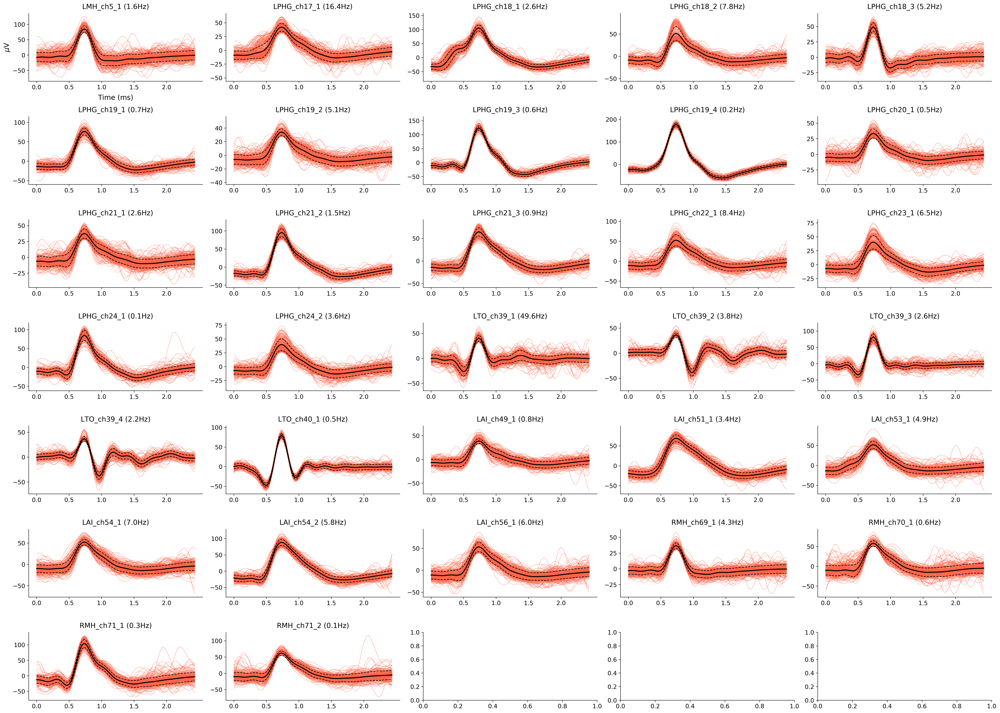

In [91]:
# Plot a selection of spike waveforms for each neuron.
samp_spikes = 200

n_neurons = len(spikes)
n_rows = np.int(np.ceil(n_neurons / 5))
fig, ax = plt.subplots(n_rows, 5, figsize=(20, n_rows*4), dpi=300)
ax = np.ravel(ax)

tickfontsize = 12
labelfontsize = 14
figfontsize = 18

neurons = list(spikes.keys())
for i, neuron in enumerate(neurons):
    mean_waveform = np.mean(spikes[neuron]['waveforms'], 0)
    std_waveform = np.std(spikes[neuron]['waveforms'], 0)
    fr = np.round(spikes[neuron]['fr'], 1)
    n_spikes = spikes[neuron]['waveforms'].shape[0]
    n_samples = len(mean_waveform)
    x_units = np.arange(n_samples) / (sr/1000)  # ms
    if n_spikes > samp_spikes:
        waves = spikes[neuron]['waveforms'][np.linspace(0, n_spikes-1, samp_spikes, dtype=np.int), :]
    else:
        waves = spikes[neuron]['waveforms']
    
    for iSpike in range(waves.shape[0]):
        ax[i].plot(x_units, waves[iSpike, :], color='tomato', alpha=0.67, linewidth=0.6)
    ax[i].plot(x_units, mean_waveform - std_waveform, color='k', linewidth=1.2, linestyle='--')
    ax[i].plot(x_units, mean_waveform + std_waveform, color='k', linewidth=1.2, linestyle='--')
    ax[i].plot(x_units, mean_waveform, color='k', linewidth=2)
    ax[i].set_xticks(np.arange(0, x_units[-1], 0.5))
    if i == 0:
        ax[i].set_xlabel('Time (ms)', fontsize=labelfontsize, labelpad=8)
        ax[i].set_ylabel('$\mu$V', fontsize=labelfontsize, labelpad=4)
    else:
        ax[i].set_xlabel('')
        ax[i].set_ylabel('')
    ax[i].set_title(neuron, fontsize=labelfontsize, y=1.02)
    ax[i].annotate('{:,d} spikes\n({:.1f}Hz)'.format(n_spikes, fr), 
                   (0.5, 0.8), xycoords='axes fraction', fontsize=labelfontsize)

fig.tight_layout(h_pad=1.12, w_pad=1.12)

if True:
    fig.savefig(os.path.join('/Users/danielschonhaut/penn/lab/projects/time_cells/data', subj, sess, 
                             'spikes', 'wave_clus3_sortbyhand', 'all_neuron_waveforms.png'),
                format='png', dpi=300, bbox_inches='tight')
    fig.savefig(os.path.join('/Users/danielschonhaut/penn/lab/projects/time_cells/data', subj, sess, 
                             'spikes', 'wave_clus3_sortbyhand', 'all_neuron_waveforms.pdf'),
                format='pdf', dpi=300, bbox_inches='tight')

In [58]:
_ = spike_preproc.format_spikes(subj_sess, 
                                lfp_timestamps_conv_factor=1e3,
                                calc_fr=False, 
                                proj_dir='/Users/danielschonhaut/penn/lab/projects/time_cells', 
                                spikes_dirname='wave_clus3_sortbyhand',
                                save_output=False,
                                verbose=True)

Found 70 wave_clus files.

session duration is 99 min and 55 sec

Found 32 neurons
Firing rates:
count    32.000000
mean      4.882724
std       8.845537
min       0.131756
25%       0.703771
50%       2.615866
75%       5.356109
max      49.600471
Name: fr, dtype: float64

        unit  chan        fr
hemroi                      
LAI        6     5  5.332801
LMH        1     1  1.612766
LPHG      16     8  2.615866
LTO        5     2  2.570752
RMH        4     3  0.453226


,subj_sess,subj,sess,chan,unit,sess_stop_time,spike_times,n_spikes,fr,hemroi
0,U521_ses0,U521,ses0,5,1,5995910,"[810, 2374, 4033, 4970, 5025, 8048, 10249, 116...",9670,1.612766,LMH
1,U521_ses0,U521,ses0,17,1,5995910,"[78, 88, 346, 425, 467, 493, 533, 553, 573, 78...",98333,16.400010,LPHG
2,U521_ses0,U521,ses0,18,1,5995910,"[647, 746, 1005, 1015, 1853, 1989, 2000, 2009,...",15818,2.638131,LPHG
3,U521_ses0,U521,ses0,18,2,5995910,"[298, 444, 652, 736, 778, 969, 975, 989, 1002,...",47013,7.840844,LPHG
4,U521_ses0,U521,ses0,18,3,5995910,"[182, 191, 199, 661, 796, 1119, 1306, 1312, 13...",31302,5.220558,LPHG
5,U521_ses0,U521,ses0,19,1,5995910,"[196, 1325, 7887, 8206, 12853, 15111, 15127, 1...",4382,0.730831,LPHG
6,U521_ses0,U521,ses0,19,2,5995910,"[710, 1004, 1370, 1450, 1860, 1963, 1975, 2395...",30578,5.099809,LPHG
7,U521_ses0,U521,ses0,19,3,5995910,"[8109, 12862, 15212, 15507, 18814, 19247, 2551...",3733,0.622591,LPHG
8,U521_ses0,U521,ses0,19,4,5995910,"[976, 1125, 7645, 15993, 44775, 49627, 53696, ...",1084,0.180790,LPHG
9,U521_ses0,U521,ses0,20,1,5995910,"[1322, 1351, 3102, 3762, 3883, 7647, 10127, 15...",3072,0.512349,LPHG


## LFP traces

In [5]:
subj_sess = 'U526_ses0'
chans = ['257', '264']
sr = 30000

subj, sess = subj_sess.split('_')

In [53]:
is_blackrock = True
lfp_dir = '/Users/danielschonhaut/Box Sync/penn/rotations/kahana/projects/time_cells/data/{}/{}/micro_lfps'.format(subj, sess)
save_data = False
save_fname = os.path.join(lfp_dir, 'CSC{}.pkl')

# ----------------------------
# Load LFPs.
lfps = []
for chan in chans:
    f = os.path.join(lfp_dir, 'CSC{}.mat'.format(chan))
    if not os.path.exists(f):
        print('Missing {}'.format(f))
        continue
    with h5py.File(f, 'r') as f:
        lfp = np.squeeze(f['data'])
    # Divide Blackrock LFPs by 4 to put values in microvolts.
    if is_blackrock:
        lfp = lfp / 4.0
    savef = save_fname.format(chan)
    if (save_data) and (not os.path.exists(savef)):
        dio.save_pickle(lfp, savef)
    lfps.append(lfp)
lfps = np.array(lfps)
print('LFPs: {}'.format(lfps.shape))
del lfp

# Load LFP timestamps.
lfp_timestamps_f = os.path.join(lfp_dir, 'lfpTimeStamps_micro.mat')
if os.path.exists(lfp_timestamps_f):
    try:
        lfp_timestamps = np.squeeze(loadmat(lfp_timestamps_f)['timeStamps'])
    except NotImplementedError:
        with h5py.File(lfp_timestamps_f, 'r') as f:
            lfp_timestamps = np.squeeze(f['timeStamps'])
    print('Sampling rate is {} Hz'.format(np.int(np.rint(1000 / np.mean(np.diff(lfp_timestamps))))))
else:
    print('Missing lfpTimeStamps_micro.mat')

LFPs: (2, 123585946)
Sampling rate is 30000.0 Hz


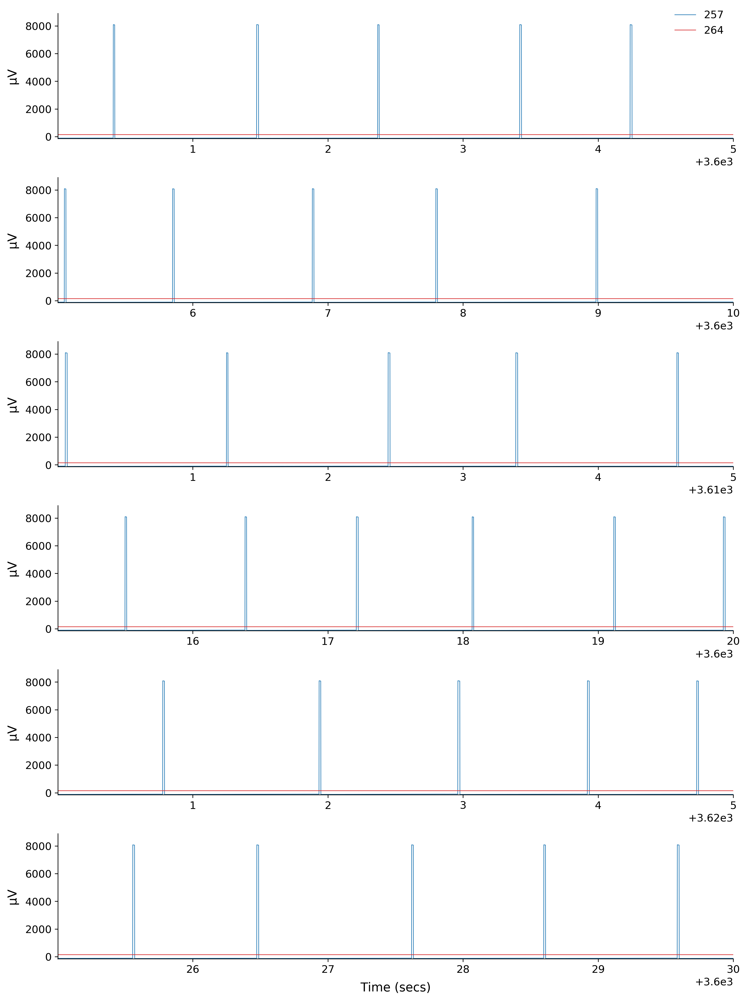

In [10]:
iChans = [0, 1]

labelfontsize = 14
tickfontsize = 12
fig, ax = plot_trace2(lfps[iChans,::30]*1e-6, 
                      start=60*60, 
                      duration=30, 
                      x_units='secs', 
                      colors=colors,
                      sampling_rate=1000,#sr,
                      legend_size=tickfontsize,
                      legend_labels=['257', '264'],
                      tickfontsize=tickfontsize,
                      labelfontsize=labelfontsize,
                      same_yaxis=False)
# ax[0].set_ylim([-200, 200])
# ax[0].set_xlabel('Time (ms)', fontsize=labelfontsize, labelpad=8)
# ax[0].set_ylabel('$\mu$V', fontsize=labelfontsize, labelpad=8)

In [65]:
# Downsample and notch filter LFPs.
#rsr = 2000
rsr = 0

lfps = eeg_preproc.process_lfp(lfps, subj_sess, chans, 
                               sampling_rate=sr, 
                               resampling_rate=rsr, 
                               notch_freqs=[60, 120, 180],
                               mean_sub=True)

In [97]:
# dat = dio.open_pickle(os.path.join(lfp_dir, 'CSC25.pkl'))
# dat_ = mne.filter.filter_data(dat, sfreq=sr, l_freq=300, h_freq=1000, verbose=False)

Setting up band-pass filter from 3e+02 - 1e+03 Hz
l_trans_bandwidth chosen to be 75.0 Hz
h_trans_bandwidth chosen to be 250.0 Hz
Filter length of 1321 samples (0.044 sec) selected


In [23]:
# fname = os.path.join(lfp_dir, 'processed', 'test.mat')
# savemat(fname, {'chan': np.arange(20)})
# loadmat(fname)

{'__header__': b'MATLAB 5.0 MAT-file Platform: posix, Created on: Sun Jan  5 15:28:19 2020',
 '__version__': '1.0',
 '__globals__': [],
 'chan': array([[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
         16, 17, 18, 19]])}

In [76]:
# # Save processed LFP channels.
# fext = '.mat' # .pkl or .mat

# # ----------------------------
# fname = os.path.join(lfp_dir, 'processed', 'CSC{}-muV-{}Hz-notchfilt' + fext)

# if fext == '.pkl':
#     for chan in chans:
#         dio.save_pickle(lfps.sel(channel=chan).data, fname.format(chan, int(lfps.samplerate)))
# elif fext == '.mat':
#     for chan in chans:
#         savemat(fname.format(chan, int(lfps.samplerate)), {'chan': lfps.sel(channel=chan).data})
# else:
#     print('File type not supported.')

In [57]:
import eeg_plotting
reload(eeg_plotting)
from eeg_plotting import plot_trace, plot_trace2

In [68]:
lfps.data.shape#[iChans,::30].shape

(5, 179877325)

In [75]:
# iChans = [1, 4]

# labelfontsize = 14
# tickfontsize = 12
# fig, ax = plot_trace2(lfps.data[iChans,::30]*1e-6, 
#                       start=30*60, 
#                       duration=30, 
#                       x_units='secs', 
#                       colors=colors,
#                       sampling_rate=1000,#sr,
#                       legend_size=tickfontsize,
#                       legend_labels=['ch2', 'ch25'],
#                       tickfontsize=tickfontsize,
#                       labelfontsize=labelfontsize,
#                       same_yaxis=False)
# # ax[0].set_ylim([-200, 200])
# # ax[0].set_xlabel('Time (ms)', fontsize=labelfontsize, labelpad=8)
# # ax[0].set_ylabel('$\mu$V', fontsize=labelfontsize, labelpad=8)

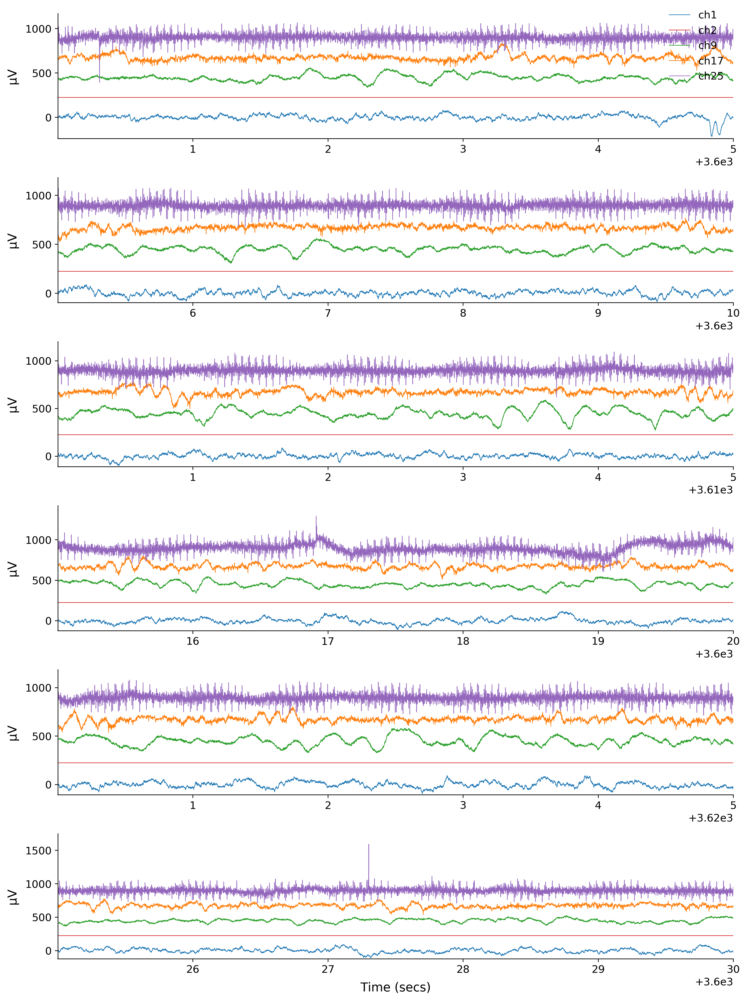

In [76]:
iChans = [0, 1, 2, 3, 4]

labelfontsize = 14
tickfontsize = 12
fig, ax = plot_trace2(lfps.data[iChans,::30]*1e-6, 
                      start=60*60, 
                      duration=30, 
                      x_units='secs', 
                      colors=colors,
                      sampling_rate=1000,#sr,
                      legend_size=tickfontsize,
                      legend_labels=['ch1', 'ch2', 'ch9', 'ch17', 'ch25'],
                      tickfontsize=tickfontsize,
                      labelfontsize=labelfontsize,
                      same_yaxis=False)
# ax[0].set_ylim([-200, 200])
# ax[0].set_xlabel('Time (ms)', fontsize=labelfontsize, labelpad=8)
# ax[0].set_ylabel('$\mu$V', fontsize=labelfontsize, labelpad=8)

Text(0.5,489.5,'Time (ms)')

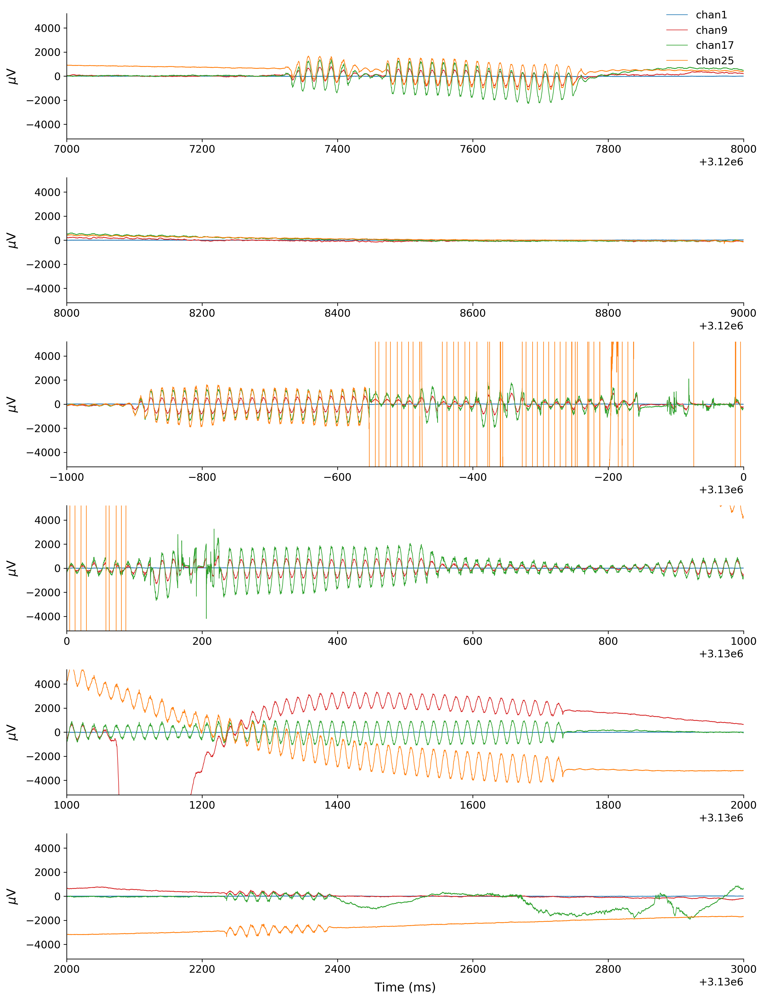

In [27]:
iChan = [0, 1, 2, 3, 4]

labelfontsize = 14
tickfontsize = 12
fig, ax = plot_trace2(lfps[iChan,:], 
                      start=52*6e4 + 7e3, duration=6e3, x_units='ms', 
                      sampling_rate=sr,
                      legend_size=tickfontsize,
                      legend_labels=['chan1', 'chan9', 'chan17', 'chan25'])
for i in range(len(ax)):
    ax[i].set_ylim([-5200, 5200])
    ax[i].set_ylabel('$\mu$V', fontsize=labelfontsize, labelpad=8)
ax[-1].set_xlabel('Time (ms)', fontsize=labelfontsize, labelpad=8)

In [13]:
print('Session is {:.1f} mins'.format(len(lfps.time) / (int(lfps.samplerate) * 60)))

Session is 62.3 mins


/Users/danielschonhaut/anaconda2/envs/py36/lib/python3.6/site-packages/matplotlib/figure.py:459: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


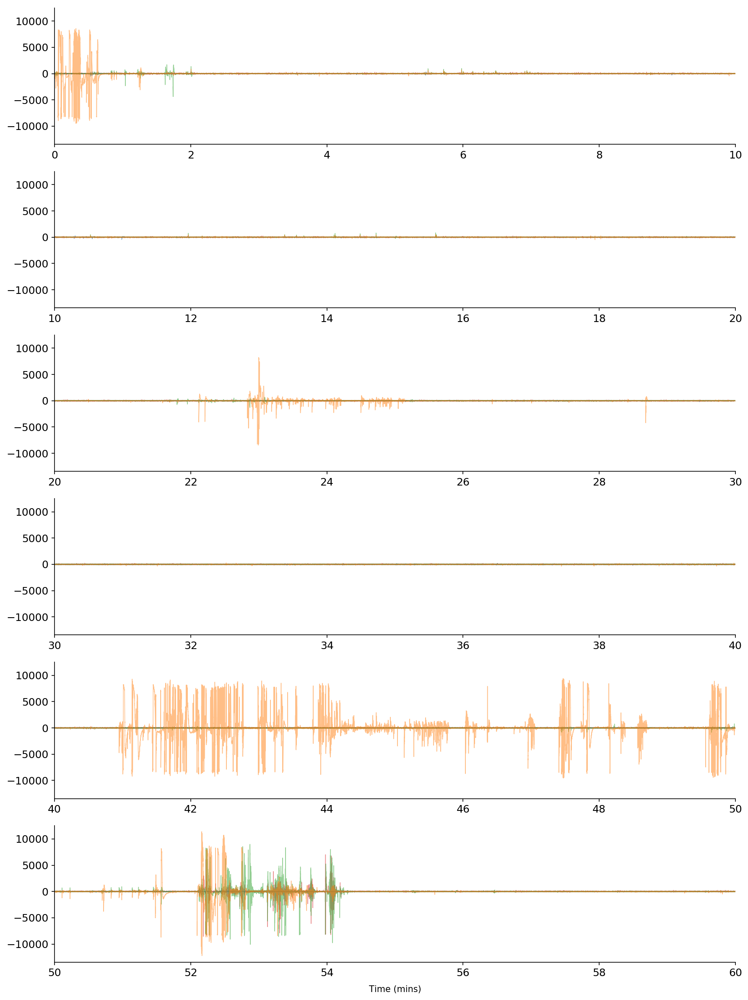

In [25]:
fig, ax = plot_trace2(lfps, start=0, duration=60, x_units='mins', sampling_rate=2000, 
                      alphas=[0.5]*len(lfps), dpi=150)

fig.show()